Using the `he_vise_eval` Conda environment.

# Visualisation of correct tiles normalisation results

In this notebook I'm going to visualise the results of the normalisation on the single tiles.\
Different algorithms and target images/parameters have been used:

- from HistomicsTK:
    - Reinhard with masking
    - Reinhard without masking
    - Macenko with masking
    - Macenko without masking
- from StainTools:
    - Reinhard
    - Macenko
    - Vahadane
- from TorchVahadane:
    - Vahadane on CPU
    - Vahadane on GPU
- from StainNET
    - StainNET pre-trained with the Camelyon16 breast cancer dataset
    - StainGAN model A pre-trained with the Camelyon16 breast cancer dataset
    - StainGAN model B pre-trained with the Camelyon16 breast cancer dataset

In most of the cases these are the same methods applied different times, so they should return the same results. However, the different in using or not using the masks should be visible.

---
# 0. - Imports and paths

In [85]:
import os
import pandas as pd
import matplotlib.font_manager as fm
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import seaborn as sns
from PIL import Image, ImageDraw
import math 
import numpy as np
from skimage.metrics import structural_similarity as ssim, peak_signal_noise_ratio as psnr
import warnings
import subprocess
import lpips
from IPython import embed
import torch, torchvision


In [86]:
# Fetch DM Sans font file from https://github.com/google/fonts/blob/main/ofl/dmsans/DMSans%5Bopsz%2Cwght%5D.ttf or, better, https://fonts.google.com/specimen/DM+Sans
font_path = "../fonts/static/DMSans-SemiBold.ttf" 

# Add font to matplotlib
try:
    fm.fontManager.addfont(font_path)
    plt.rcParams['font.family'] = 'DM Sans'
except RuntimeError as e:
    print(f"Failed to load font: {e}")

# sns.set_theme(font_scale=1.5, style="whitegrid")
# biomodal_palette = ["#9CDBD9", "#C0DF16","#003B49","#05868E", "#ABAD9A", "#F87C56","#00DAEF","#50B37B"]
# sns.set_palette(biomodal_palette)

In [87]:
# # Test plot
# plt.figure(figsize=(6, 4))
# plt.title("Test Plot with DM Sans Font μ", fontsize=16)
# plt.plot([1, 2, 3], [4, 6, 8])
# plt.show()


In [88]:
os.chdir("/disk2/user/gabgam/work/gigi_env/the_project/2_image_normalisation/")
print(os.getcwd())

# PARAMETER THAT MUST BE SPECIFIED TO AUTOMATICALLY LOOK FOR THE CORRECT FOLDERS AND PATHS
IMAGE_VERSION_AND_COORDINATE_SYSTEM = "v3_allspots" 
SPATIAL_ATAC_SAMPLE = "satac_C1"

# path to all wsi-derived tiles directories, including normalised WSI
PATH_TO_TILES_DIRECTORY = f"/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/{SPATIAL_ATAC_SAMPLE}/tiling_output/"
# all wsi-derived tiles directories
paths_to_tiles_from_wsis = [os.path.join(PATH_TO_TILES_DIRECTORY, i) for i in os.listdir(PATH_TO_TILES_DIRECTORY) if i.startswith(IMAGE_VERSION_AND_COORDINATE_SYSTEM)] # all the folder for tiles from WSIs, including the original one
print(paths_to_tiles_from_wsis)

# path to directories of singularly normalised tiles
PATH_TO_NORMALISED_TILES = f"./output/{SPATIAL_ATAC_SAMPLE}/{IMAGE_VERSION_AND_COORDINATE_SYSTEM}/"

# path to the target image
PATH_TO_REFERENCE = "./reference_images/reference_full.jpeg"
TARGET_IS = "target_is_reference_full"

# make folder for saving the resultS
FIGURES_PATH = f"figures/{SPATIAL_ATAC_SAMPLE}_{IMAGE_VERSION_AND_COORDINATE_SYSTEM}/"
os.makedirs(FIGURES_PATH, exist_ok=True)

/disk2/work/gabgam/gigi_env/the_project/2_image_normalisation
['/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/satac_C1/tiling_output/v3_allspots', '/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/satac_C1/tiling_output/v3_allspots_histomicsTK_macenko_nomasking_target_is_reference_full', '/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/satac_C1/tiling_output/v3_allspots_histomicsTK_macenko_withmasking_target_is_reference_full', '/disk2/work/gabgam/gigi_env/the_project/1_tiling/output/satac_C1/tiling_output/v3_allspots_staintools_reinhard_target_is_reference_full']


In [89]:
def normalisations_summary_from_tiles(base_dir):
    '''
    Returns a dataframe containing the number of tiles (as `.jpg` files) per normalisation method, target and the relative path.
    '''
    # Initialize a list to hold the data for the DataFrame
    data = []
        
    # Walk through the directory structure
    for root, dirs, files in os.walk(base_dir):
        # Filter .jpg files
        jpg_count = len([f for f in files if f.lower().endswith('.jpg')])

        # Parse normalisation method and target from the directory structure
        relative_path = os.path.relpath(root, base_dir)
        path_parts = relative_path.split(os.sep)

        # Initialize variables
        normalisation_method = path_parts[0] if len(path_parts) >= 1 else None
        target = "-"

        # Check for specific targets or models in deeper paths
        if len(path_parts) > 1:
            if path_parts[1].startswith("target"):
                target = path_parts[1]
            elif path_parts[1].startswith("model"):
                normalisation_method = f"{normalisation_method}_{path_parts[1]}"

        # Add the data row if a normalisation method is valid
        if normalisation_method:
            data.append({
                "Normalisation Method": normalisation_method,
                "Target": target,
                "Number of tiles": jpg_count,
                #"Path to folder": relative_path # path to the final folder as well
                "Path to folder": root # path to the final folder as well
            })
            
    
    # Create a DataFrame and filter for methods that worked
    df = pd.DataFrame(data)
    df = df[df["Number of tiles"] > 0]

    # Optionally, sort the DataFrame for better readability
    df = df.sort_values(by=["Normalisation Method", 
                            "Target"]).reset_index(drop=True)
    
    return df

# ------------------------------------------------------------------------------------------------------------------------
def normalisations_summary_from_WSI(base_dir, original_image_name):
    '''
    Returns a dataframe containing the number of tiles (as `.jpg` files) per normalisation method, target and the relative path derived from the original or normalised WSI.
    '''
    # Initialize a list to hold the data for the DataFrame
    data = []
    
    # Filter .jpg files
    jpg_count = len([f for f in os.listdir(base_dir) if f.lower().endswith('.jpg')])
    
    temp_method_n_target = base_dir.split("/")[-3]
    print(f"Processing folder: {temp_method_n_target}")
    temp_for_naming = temp_method_n_target.split("_")
    
    if temp_method_n_target == original_image_name:
        normalisation_method = "ORIGINAL WSI"
        target = "-"
    
    elif (temp_for_naming[0] + "_" + temp_for_naming[1]) == original_image_name and len(temp_for_naming) > 2:
        normalisation_method = temp_method_n_target.replace((original_image_name + "_"), '').split("_target")[0] # select just the normalisation method name
        target = temp_method_n_target.split((normalisation_method + "_"))[1] # select just the target name
        normalisation_method = "fromWSI_" + normalisation_method
    
    else:
        normalisation_method = None 
        
    if normalisation_method:
        data.append({
            "Normalisation Method": normalisation_method,
            "Target": target,
            "Number of tiles": jpg_count,
            #"Path to folder": relative_path # path to the final folder as well
            "Path to folder": base_dir # path to the final folder as well
        })
    print(jpg_count)
    # Create a DataFrame and filter for methods that worked (more than 0 tiles)
    df = pd.DataFrame(data)
    df = df[df["Number of tiles"] > 0]

    # Optionally, sort the DataFrame for better readability
    df = df.sort_values(by=["Normalisation Method", 
                            "Target"]).reset_index(drop=True)
    
    return df


# ------------------------------------------------------------------------------------------------------------------------
def cap_sentence(s):
    """
    Very simple function for capitalising the first character of every word.
    
    Paraters:
    s (string): string to modify.
    """
    return ''.join( (c.upper() if i == 0 or s[i-1] == ' ' else c) for i, c in enumerate(s) )


# ------------------------------------------------------------------------------------------------------------------------
def rgb_to_tuple(rgb_string):
    return tuple(int(x) / 255.0 for x in rgb_string.split(":"))


# ------------------------------------------------------------------------------------------------------------------------
def plot_normalisation_tiles(df, tile_size):
    """
    Create a bar plot showing the number of tiles per normalisation method for a given tile size.
    
    Parameters:
    df (pd.DataFrame): Dataframe containing normalisation method and number of tiles.
    tile_size (int): The size of the tiles in micrometers (e.g., 100 for 100um).
    """
    # Filter for Target being '-' or 'target_is_reference_full'
    df_filtered = df[df["Target"].isin(["-", TARGET_IS])]
    
    # Highlight "ORIGINAL WSI" separately
    original_value = df_filtered[df_filtered["Normalisation Method"] == "ORIGINAL WSI"]["Number of tiles"].iloc[0]
    
    # New names for better appearance
    new_names = [cap_sentence(i.replace("_", " ")) for i in df_filtered["Normalisation Method"]]    
    
    # Karolinska Institutet colors
    bar_colors = [ 
        rgb_to_tuple("79:4:51") if method == "ORIGINAL WSI" 
        else rgb_to_tuple("135:0:82") if method.startswith("fromWSI")
        else rgb_to_tuple("255:135:111") 
        for method in df_filtered["Normalisation Method"]
    ]
    
    # Create the bar plot
    plt.figure(figsize=(14, 7))
    bars = plt.bar(
        new_names, 
        df_filtered["Number of tiles"], 
        color=bar_colors, 
        edgecolor="black", 
        width=0.6
    )
    
    # Add a horizontal line for "ORIGINAL WSI"
    plt.axhline(original_value, color="red", linestyle="--", linewidth=1.5)
    plt.text(
        len(df_filtered) - 1.5, original_value + 50,
        f"ORIGINAL WSI: {original_value}", 
        color="red", 
        fontsize=10, 
        ha="right"
    )
    
    # Rotate the method names
    plt.xticks(rotation=45, ha="right", fontsize=12)
    
    # Remove legend
    plt.gca().legend_ = None
    
    # Add the values inside the bars
    for bar in bars:
        height = bar.get_height()
        plt.text(
            bar.get_x() + bar.get_width() / 2, 
            height - 150,
            f"{int(height)}", 
            ha="center", 
            color="white", 
            fontsize=10, 
            weight="bold"
        )
    
    # Improve plot appearance
    plt.title(f"Number of tiles per normalisation method - {tile_size} um tiles", fontsize=16)
    plt.ylabel("Number of Tiles", fontsize=14)
    plt.tight_layout()
    
    plt.savefig(os.path.join(FIGURES_PATH, f"summary_of_normalisation_{tile_size}um_tiles.png"), format = "PNG")
    plt.savefig(os.path.join(FIGURES_PATH, f"summary_of_normalisation_{tile_size}um_tiles.pdf"), format = "PDF")
    
    # Show the plot
    plt.show()


# ------------------------------------------------------------------------------------------------------------------------
def plot_comparison_by_origin(list_of_lists, tile_to_visualise, tile_size):
    """
    Plots and saves comparison images for each normalization method.
    
    Parameters:
    - list_of_lists: List of lists containing method names and folder paths.
    - tile_to_visualise: Name of the tile to visualize.
    - tile_size: Size of the tile (e.g., "100um"), used for saving filenames.
    """
    origin_names = [method.split(" ")[0] for method in [item[0] for item in list_of_lists] if method.split(" ")[0] not in ["ORIGINAL", "Target"]]

    for origin in set(origin_names):
        
        # in case of DL models we don't want to plot the target image, so we just select the tile from original WSI
        if origin in ["StainNET", "StainGAN"]:
            just_original_n_target = [these for these in list_of_lists if these[0].startswith(("ORIGINAL"))] 
            temp_list_of_list_for_origin = just_original_n_target + [i for i in list_of_lists if i[0].startswith(origin)]
            
        else: 
            just_original_n_target = [these for these in list_of_lists if these[0].startswith(("ORIGINAL", "Target"))]
            temp_list_of_list_for_origin = just_original_n_target + [i for i in list_of_lists if i[0].startswith(origin)]
            
            
        n_rows, n_cols = 1, len(temp_list_of_list_for_origin)
        fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 5, n_rows * 5))
        font = 15

        for i, ax in enumerate(axes.flat):
            if temp_list_of_list_for_origin[i][0] == "ORIGINAL WSI":
                for tile in os.listdir(temp_list_of_list_for_origin[i][1]):
                    if tile.startswith(tile_to_visualise):
                        img = Image.open(os.path.join(temp_list_of_list_for_origin[i][1], tile))
                        ax.imshow(img)
                        ax.set_title(f"TILE FROM THE {temp_list_of_list_for_origin[i][0]}", fontsize=font)

            elif temp_list_of_list_for_origin[i][0] == "Target image":
                target = Image.open(temp_list_of_list_for_origin[i][1])
                new_size = (556, 556)
                resized_target = target.resize(new_size, Image.Resampling.LANCZOS)
                ax.imshow(resized_target)
                ax.set_title(temp_list_of_list_for_origin[i][0], fontsize=font)

            else:
                for tile in os.listdir(temp_list_of_list_for_origin[i][1]):
                    if tile.startswith(tile_to_visualise):
                        img = Image.open(os.path.join(temp_list_of_list_for_origin[i][1], tile))
                        ax.imshow(img)
                        ax.set_title(temp_list_of_list_for_origin[i][0], fontsize=font)

            ax.axis("off")

        plt.tight_layout()
        fig.savefig(os.path.join(FIGURES_PATH, f"comparison_{origin}_results_for_{tile_to_visualise}_{tile_size}.pdf"), format="pdf", bbox_inches="tight")
        fig.savefig(os.path.join(FIGURES_PATH, f"comparison_{origin}_results_for_{tile_to_visualise}_{tile_size}.png"), format="png", dpi=300, bbox_inches="tight")
        plt.show()


# ------------------------------------------------------------------------------------------------------------------------
def calculate_white_percentage(image_path, reference_color, tolerance=50, max_white_perc = None):
    """
    Calculates the percentage of pixels in an image that match a reference color within a tolerance range.

    Parameters:
    - image_path: Path to the image.
    - reference_color: Reference RGB color as a list or array, e.g., [214, 207, 210].
    - tolerance: Allowed difference between the pixel and the reference color. Default is 50.

    Returns:
    - Percentage of white-like pixels in the image.
    """
    # Load the image and convert to a NumPy array
    img = Image.open(image_path).convert("RGB")
    img_array = np.array(img)

    # Calculate the absolute difference from the reference color
    diff = np.abs(img_array - reference_color)

    # Find pixels that match the reference color within the tolerance
    matches = np.all(diff <= tolerance, axis=-1)

    # Calculate the percentage of matching pixels
    match_percentage = np.sum(matches) / matches.size * 100
    
    if match_percentage > max_white_perc:
        return pd.DataFrame([[os.path.basename(image_path), match_percentage]], columns = ["Tile name", "White percentage"])
    else:
        return
    
    
# ------------------------------------------------------------------------------------------------------------------------
def compute_similarity_metrics(selected_tiles, path_to_original, norm_methods, norm_paths, tile_size, output_dir):
    """
    Computes SSIM and PSNR between original and normalized tiles and saves the results as CSV files.
    
    Parameters:
    - selected_tiles: List of tile names to process.
    - path_to_original: Path to the directory containing original tiles.
    - norm_methods: List of normalization method names.
    - norm_paths: List of paths corresponding to the normalization methods.
    - tile_size: Tile size in micrometers, used for naming output files.
    - output_dir: Directory where output CSV files will be saved.
    """
    
    # DataFrames to store SSIM and PSNR values
    ssim_df = pd.DataFrame()
    psnr_df = pd.DataFrame()
    
    # Suppress warnings for divide-by-zero in PSNR
    warnings.filterwarnings("ignore", category=RuntimeWarning)
    
    # looping over every tile which passed the white-percentage test
    for source_tile in selected_tiles:
        tile_row_ssim = {}
        tile_row_psnr = {}
        
        # loading the original tile
        source_tile_path = os.path.join(path_to_original, source_tile)
        source_tile_image = np.array(Image.open(source_tile_path).convert("RGB"))
        source_tile_name = source_tile.replace(".jpg", "")
        
        for norm_method, norm_path in zip(norm_methods, norm_paths):
            if norm_method == "ORIGINAL WSI":
                continue
            
            try:
                target_path = [os.path.join(norm_path, i) for i in os.listdir(norm_path) if i.startswith(source_tile_name)]
                
                if not target_path:
                    print(f"Warning: No matching tile found for {source_tile_name} in {norm_method}")
                    continue  # Skip to next method
                
                target_tile_im = Image.open(target_path[0]).convert("RGB")
                target_tile_image = np.array(target_tile_im)

                # Debugging
                #print(f"{source_tile_name} ({norm_method}): Original size = {source_tile_image.shape}, Normalized size = {target_tile_image.shape}")

                # Ensure both images have the same size
                if source_tile_image.shape != target_tile_image.shape:
                    raise ValueError(f"Size mismatch: {source_tile_image.shape} vs {target_tile_image.shape}")
                
                index = ssim(source_tile_image, target_tile_image, data_range=target_tile_image.max() - target_tile_image.min(), channel_axis=2)
                ratio = psnr(source_tile_image, target_tile_image, data_range=target_tile_image.max() - target_tile_image.min())

                tile_row_ssim[norm_method] = index
                tile_row_psnr[norm_method] = ratio
                
            except Exception as e:
                print(f"Error processing {source_tile} for {norm_method}: {e}")

        
        ssim_df = pd.concat([ssim_df, pd.DataFrame(tile_row_ssim, index=[source_tile])])
        psnr_df = pd.concat([psnr_df, pd.DataFrame(tile_row_psnr, index=[source_tile])])
    
    # selecting the correct path to the saving folder
    output_path = os.path.join(output_dir, f"tiles_{tile_size}")
    os.makedirs(output_path, exist_ok=True)
    
    # saving as .csv file
    ssim_df.to_csv(os.path.join(output_path, f"ssim_of_methods_for_non_white_tiles_{tile_size}um.csv"))
    psnr_df.to_csv(os.path.join(output_path, f"psnr_of_methods_for_non_white_tiles_{tile_size}um.csv"))
    
    return ssim_df, psnr_df


# ------------------------------------------------------------------------------------------------------------------------
def compute_lpips_metrics(selected_tiles, path_to_original, norm_methods, norm_paths, tile_size, output_dir, use_gpu=True):
    """
    Computes LPIPS between original and normalized tiles, saving results as CSV files.
    
    Parameters:
    - selected_tiles: List of tile names to process.
    - path_to_original: Path to the directory containing original tiles.
    - norm_methods: List of normalization method names.
    - norm_paths: List of paths corresponding to the normalization methods.
    - tile_size: Tile size in micrometers, used for naming output files.
    - output_dir: Directory where output CSV files will be saved.
    - use_gpu: Whether to use GPU for LPIPS computation (default: True).
    """
    
    # DataFrames to store LPIPS values
    lpips_df = pd.DataFrame() 
    
    # Suppress warnings for divide-by-zero in PSNR
    warnings.filterwarnings("ignore", category=RuntimeWarning)
    
    # Initialize LPIPS loss function if needed
    loss_fn = lpips.LPIPS(net='alex', spatial=False)
    if use_gpu:
        loss_fn.cuda()
    
    for source_tile in selected_tiles:
        tile_row_lpips = {} 
        
        # Load original tile
        source_tile_path = os.path.join(path_to_original, source_tile)
        source_tile_image = np.array(Image.open(source_tile_path).convert("RGB"))
        source_tile_name = source_tile.replace(".jpg", "")
        
        for norm_method, norm_path in zip(norm_methods, norm_paths):
            if norm_method == "ORIGINAL WSI":
                continue
            
            try:
                target_path = [os.path.join(norm_path, i) for i in os.listdir(norm_path) if i.startswith(source_tile_name)]
                if not target_path:
                    print(f"Warning: No matching tile found for {source_tile_name} in {norm_method}")
                    continue
                
                target_tile_image = np.array(Image.open(target_path[0]).convert("RGB"))
                
                if source_tile_image.shape != target_tile_image.shape:
                    raise ValueError(f"Size mismatch: {source_tile_image.shape} vs {target_tile_image.shape}")
                
                # Compute LPIPS if enabled
                src_tensor = torch.tensor(source_tile_image / 127.5 - 1, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0)
                tgt_tensor = torch.tensor(target_tile_image / 127.5 - 1, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0)

                src_tensor = src_tensor.cuda()
                tgt_tensor = tgt_tensor.cuda()

                lpips_score = loss_fn(src_tensor, tgt_tensor).item()
                tile_row_lpips[norm_method] = lpips_score
                
            except Exception as e:
                print(f"Error processing {source_tile} for {norm_method}: {e}")
        
        lpips_df = pd.concat([lpips_df, pd.DataFrame(tile_row_lpips, index=[source_tile])])
    
    output_path = os.path.join(output_dir, f"tiles_{tile_size}")
    os.makedirs(output_path, exist_ok=True)
        
    lpips_df.to_csv(os.path.join(output_path, f"lpips_of_methods_for_non_white_tiles_{tile_size}um.csv"))
    
    return lpips_df 


# ------------------------------------------------------------------------------------------------------------------------
def plot_boxplot(metric_df, metric, title, median = False):
    """
    Plots a boxplot of the choosen metric eventually with median values placed just after Q1.
    """
    # Define color palette
    box_palette = {
        method: rgb_to_tuple("135:0:82") if method.startswith("FromWSI") else rgb_to_tuple("255:135:111")
        for method in metric_df.columns
    }

    fig, ax = plt.subplots(figsize=(14, 8))

    # Create boxplot
    sns.boxplot(data=metric_df, showfliers=False, ax=ax, palette=box_palette)

    # Labels & formatting
    plt.xticks(rotation=45, ha="right")
    plt.ylabel(f"{metric} Score")
    plt.title(title)
    plt.grid(axis="both", linestyle="--", alpha=0.7)

    # loop for the median
    if median:
        # Compute Q1 (25th percentile) and median
        q1_values = metric_df.quantile(0.25)
        medians = metric_df.median()

        # Add median values just after Q1
        for i, (q1, median) in enumerate(zip(q1_values, medians)):
            ax.text(i, q1 - 0.06, f"{median:.3f}", ha="center", va="bottom", fontsize=10, color="black", fontweight="bold")
    
    fig.subplots_adjust(bottom=0.5, left=0.15)  # Increase bottom margin
    
    file_name = f"boxplot_{title}".replace(" ", "_")

    fig.savefig(os.path.join(FIGURES_PATH, f"{file_name}.pdf"), format = "PDF")
    fig.savefig(os.path.join(FIGURES_PATH, f"{file_name}.PNG"), format = "PNG")
    
    plt.show()


# ------------------------------------------------------------------------------------------------------------------------
def plot_violinplot(metric_df, metric, title, median = False):
    """
    Plots a violinplot of the choosen metric eventually with median values placed just after Q1.
    """
    # Define color palette
    violin_palette = {
        method: rgb_to_tuple("135:0:82") if method.startswith("FromWSI") else rgb_to_tuple("255:135:111")
        for method in metric_df.columns
    }

    fig, ax = plt.subplots(figsize=(14, 6))

    # Create violinplot
    sns.violinplot(data=metric_df, ax=ax, palette=violin_palette)

    # Labels & formatting
    plt.xticks(rotation=45, ha="right")
    plt.ylabel(f"{metric} Score")
    plt.title(title)
    plt.grid(axis="both", linestyle="--", alpha=0.7)

    if median:        
        # Compute Q1 (25th percentile) and median
        q1_values = metric_df.quantile(0.25)
        medians = metric_df.median()

        # Add median values just after Q1
        for i, (q1, median) in enumerate(zip(q1_values, medians)):
            ax.text(i, q1 - 0.06, f"{median:.3f}", ha="center", va="bottom", fontsize=10, color="black", fontweight="bold")
    
    fig.subplots_adjust(bottom=0.5, left=0.15)  # Increase bottom margin
    
    file_name = f"violinplot_{title}".replace(" ", "_")

    fig.savefig(os.path.join(FIGURES_PATH, f"{file_name}.pdf"), format = "PDF")
    fig.savefig(os.path.join(FIGURES_PATH, f"{file_name}.PNG"), format = "PNG")
    
    plt.show()

# 1. - Visualisation

First of all, let's see how many tiles where normalised for each method:

## 1.1 - Spatial ATAC-seq tiles
For the image `v3_allspots`, we are going to check how many tiles where generated from the original WSI and how many where processed for every method.

In [90]:
max_number_of_tiles = len([i for i in os.listdir(os.path.join(PATH_TO_TILES_DIRECTORY, IMAGE_VERSION_AND_COORDINATE_SYSTEM, 'tiles_100'))])

print(f"From the original WSI, {max_number_of_tiles} tiles were generated") # I took tiles_100 as an example, can also be done with tiles_50

From the original WSI, 3631 tiles were generated


### 1.1.1 - 100 μm normalised tiles

First of all, let's see how many tiles singularly and successfully passed the normalisation steps.

In [91]:
tile_size = 100

In [92]:
path_to_100um_normalised_tiles = os.path.join(os.getcwd(), PATH_TO_NORMALISED_TILES, f"tiles_{tile_size}/")
path_to_100um_normalised_tiles

df_100_norm_tiles = normalisations_summary_from_tiles(path_to_100um_normalised_tiles)
#df_100_norm_tiles.to_csv(f"{path_to_100um_normalised_tiles}summary_normalised_tiles_from_tiling_100um.csv")
df_100_norm_tiles

,Normalisation Method,Target,Number of tiles,Path to folder
0,histomicsTK_macenko_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
1,histomicsTK_macenko_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
2,histomicsTK_reinhard_nomasking,target_is_default,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
3,histomicsTK_reinhard_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
4,histomicsTK_reinhard_withmasking,target_is_default,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
5,histomicsTK_reinhard_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
6,stainGAN_model_A,-,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
7,stainGAN_model_B,-,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
8,stainNET,-,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
9,staintools_macenko,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...


In [93]:
print(df_100_norm_tiles[df_100_norm_tiles["Normalisation Method"] == "histomicsTK_reinhard_nomasking"]["Path to folder"].loc[2])

/disk2/work/gabgam/gigi_env/the_project/2_image_normalisation/./output/satac_C1/v3_allspots/tiles_100/histomicsTK_reinhard_nomasking/target_is_default


Let's also visualise the results of tiling from the **normalised WSI**.

In [94]:
df_from_wsis_100_norm_tiles = pd.DataFrame()

# looping over all the paths to the tiles derived from WSIs
for path in paths_to_tiles_from_wsis:
    
    path_to_100 = os.path.join(path, f"tiles_{tile_size}/")
    path_to_100
    
    # Creating the same dataframe as the one above but for tiles derived from the WSI normalisation
    df = normalisations_summary_from_WSI(path_to_100, IMAGE_VERSION_AND_COORDINATE_SYSTEM)
    df_from_wsis_100_norm_tiles = pd.concat([df_from_wsis_100_norm_tiles, df], ignore_index=True)
    
#df_from_wsis_norm_tiles.to_csv(f"{path_to_100}summary_tiles_from_WSIs_100um.csv")
df_from_wsis_100_norm_tiles

Processing folder: v3_allspots
3631
Processing folder: v3_allspots_histomicsTK_macenko_nomasking_target_is_reference_full
3631
Processing folder: v3_allspots_histomicsTK_macenko_withmasking_target_is_reference_full
3631
Processing folder: v3_allspots_staintools_reinhard_target_is_reference_full
3631


,Normalisation Method,Target,Number of tiles,Path to folder
0,ORIGINAL WSI,-,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
1,fromWSI_histomicsTK_macenko_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
2,fromWSI_histomicsTK_macenko_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
3,fromWSI_staintools_reinhard,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...


Now we can join the two dataframes and save the final result.

In [95]:
final_summary_for_all_100um_normalised_tiles = pd.concat([df_from_wsis_100_norm_tiles, df_100_norm_tiles])

# save the table
final_summary_for_all_100um_normalised_tiles.to_csv(os.path.join(path_to_100um_normalised_tiles, f"final_summary_for_all_{tile_size}um_normalised_tiles.csv"))
final_summary_for_all_100um_normalised_tiles

,Normalisation Method,Target,Number of tiles,Path to folder
0,ORIGINAL WSI,-,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
1,fromWSI_histomicsTK_macenko_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
2,fromWSI_histomicsTK_macenko_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
3,fromWSI_staintools_reinhard,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
0,histomicsTK_macenko_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
1,histomicsTK_macenko_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
2,histomicsTK_reinhard_nomasking,target_is_default,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
3,histomicsTK_reinhard_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
4,histomicsTK_reinhard_withmasking,target_is_default,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
5,histomicsTK_reinhard_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...


As a summary, this table contains all the normalisation methods that have been used, the target (if necessary), the number of generated tiles and the path to the folder.\
Moreover, I've also added the path to the directory containing the tiles derived from the original WSI that didn't undergo the normalisation step.

As we have already said, 3631 is the maximum number of tiles that we can have, thus, considering that we have 3631 for each normalisation method with target `reference_full.jpeg`, we can say that the approach is correct.

<br />
In the meanwhile, let's also have a quick visualisation of it.

In [96]:
# Filter for Target being '-' or 'target_is_reference_full'
df_filtered_100 = final_summary_for_all_100um_normalised_tiles[final_summary_for_all_100um_normalised_tiles["Target"].isin(["-", TARGET_IS])]
# Highlight "ORIGINAL WSI" separately
original_value = df_filtered_100[df_filtered_100["Normalisation Method"] == "ORIGINAL WSI"]["Number of tiles"].iloc[0]

# New names for better appearence
new_names = [cap_sentence(i.replace("_", " ")) for i in df_filtered_100["Normalisation Method"]]


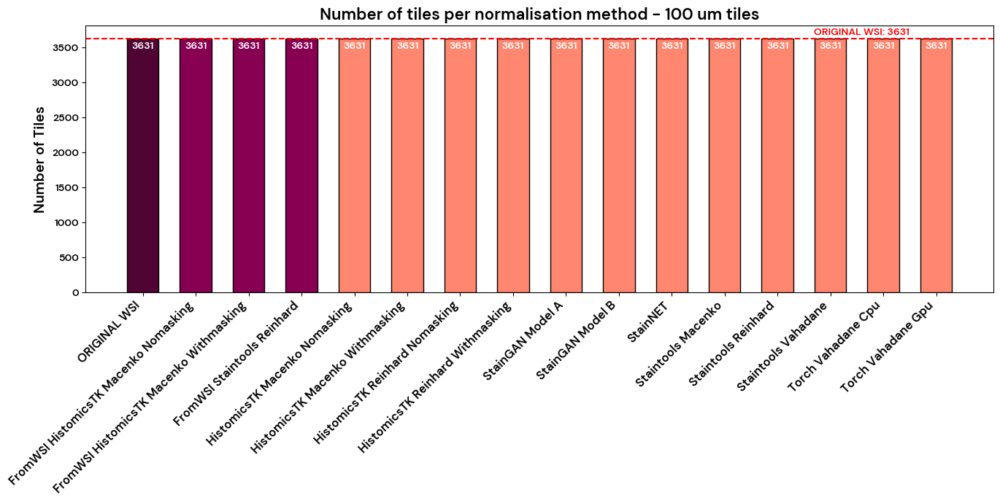

In [97]:
plot_normalisation_tiles(final_summary_for_all_100um_normalised_tiles, tile_size)

### 1.1.2 - 68 μm normalised tiles
Now, let's repeat the previous step but with the 68 μm tiles.

In [98]:
spot_size = 68

In [99]:
path_to_68um_normalised_tiles = os.path.join(os.getcwd(), PATH_TO_NORMALISED_TILES, f"tiles_{spot_size}")
path_to_68um_normalised_tiles

df_68_norm_tiles = normalisations_summary_from_tiles(path_to_68um_normalised_tiles)
#df_68_norm_tiles.to_csv(f"{path_to_68um_normalised_tiles}summary_normalised_tiles_from_tiling_68um.csv")
df_68_norm_tiles

,Normalisation Method,Target,Number of tiles,Path to folder
0,histomicsTK_macenko_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
1,histomicsTK_macenko_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
2,histomicsTK_reinhard_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
3,histomicsTK_reinhard_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
4,stainGAN_model_A,-,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
5,stainGAN_model_B,-,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
6,stainNET,-,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
7,staintools_macenko,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
8,staintools_reinhard,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
9,staintools_vahadane,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...


In [100]:
df_from_wsis_68_norm_tiles = pd.DataFrame()

# looping over all the paths to the tiles derived from WSIs
for path in paths_to_tiles_from_wsis:
    
    path_to_68 = os.path.join(path, f"tiles_{spot_size}/")
    path_to_68
    
    df = normalisations_summary_from_WSI(path_to_68, IMAGE_VERSION_AND_COORDINATE_SYSTEM)
    df_from_wsis_68_norm_tiles = pd.concat([df_from_wsis_68_norm_tiles, df], ignore_index=True)
    
#df_from_wsis_68_norm_tiles.to_csv(f"{path_to_68}summary_tiles_from_WSIs_68um.csv")
df_from_wsis_68_norm_tiles

Processing folder: v3_allspots
3631
Processing folder: v3_allspots_histomicsTK_macenko_nomasking_target_is_reference_full
3631
Processing folder: v3_allspots_histomicsTK_macenko_withmasking_target_is_reference_full
3631
Processing folder: v3_allspots_staintools_reinhard_target_is_reference_full
3631


,Normalisation Method,Target,Number of tiles,Path to folder
0,ORIGINAL WSI,-,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
1,fromWSI_histomicsTK_macenko_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
2,fromWSI_histomicsTK_macenko_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
3,fromWSI_staintools_reinhard,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...


In [101]:
final_summary_for_all_68um_normalised_tiles = pd.concat([df_from_wsis_68_norm_tiles, df_68_norm_tiles])

# save the table
final_summary_for_all_68um_normalised_tiles.to_csv(os.path.join(path_to_68um_normalised_tiles, f"final_summary_for_all_{spot_size}um_normalised_tiles.csv"))
final_summary_for_all_68um_normalised_tiles

,Normalisation Method,Target,Number of tiles,Path to folder
0,ORIGINAL WSI,-,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
1,fromWSI_histomicsTK_macenko_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
2,fromWSI_histomicsTK_macenko_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
3,fromWSI_staintools_reinhard,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/1_tili...
0,histomicsTK_macenko_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
1,histomicsTK_macenko_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
2,histomicsTK_reinhard_nomasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
3,histomicsTK_reinhard_withmasking,target_is_reference_full,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
4,stainGAN_model_A,-,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...
5,stainGAN_model_B,-,3631,/disk2/work/gabgam/gigi_env/the_project/2_imag...


Let's have a more direct view at it as a histogram.

In [102]:
# Filter for Target being '-' or 'target_is_reference_full'
df_filtered_68 = final_summary_for_all_68um_normalised_tiles[final_summary_for_all_68um_normalised_tiles["Target"].isin(["-", TARGET_IS])]
# Highlight "ORIGINAL WSI" separately
original_value = df_filtered_68[df_filtered_68["Normalisation Method"] == "ORIGINAL WSI"]["Number of tiles"].iloc[0]

# New names for better appearence
new_names = [cap_sentence(i.replace("_", " ")) for i in df_filtered_68["Normalisation Method"]]

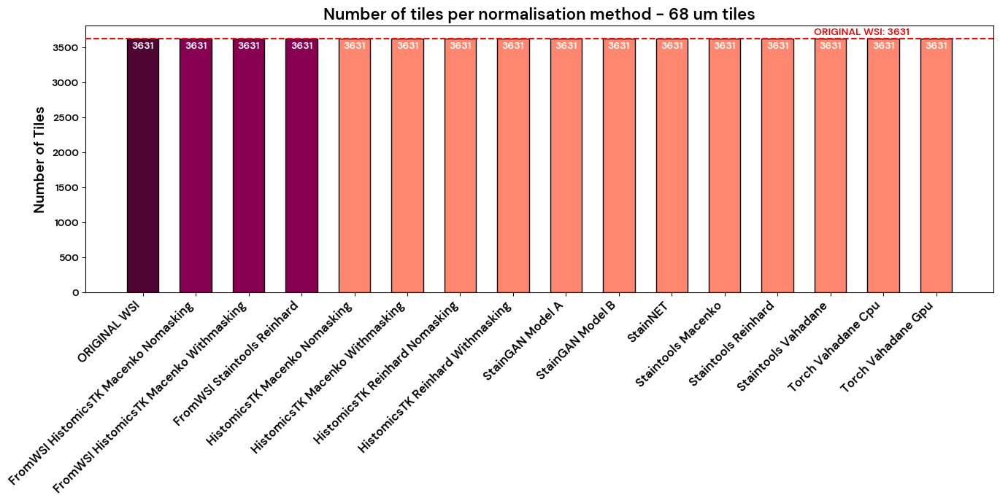

In [103]:
plot_normalisation_tiles(final_summary_for_all_68um_normalised_tiles, spot_size)

---

# 2. - Quality control
So, referring to the number of computed normalisations for each method, we can say that now the cropping function is working properly as all the images for all the methods have been correctly normalised.\
Now, let's visualised some of them.

Let's specify the name of the tile that we want to plot. The barcode and the grid coordinate system names are enough.

In [38]:
TILE_TO_VISUALISE = "AAGCCATAGTCGCGAC_row1_col1"  #barcode_rowingrid_coloumningrid

## 2.1 - Visualisation of some 100 μm normalised tiles

Once again, here wee are referring to the tiles normalised with the target initially specified.

In [39]:
#print(df_filtered_100)
temp_for_plotting_specific_tile_100 = df_filtered_100.loc[:, ["Normalisation Method", "Path to folder"]]
temp_for_plotting_specific_tile_100.loc[:, "Normalisation Method"] = new_names

list_of_lists_100 = temp_for_plotting_specific_tile_100.values.tolist()
list_of_lists_100.insert(1, ["Target image", PATH_TO_REFERENCE])

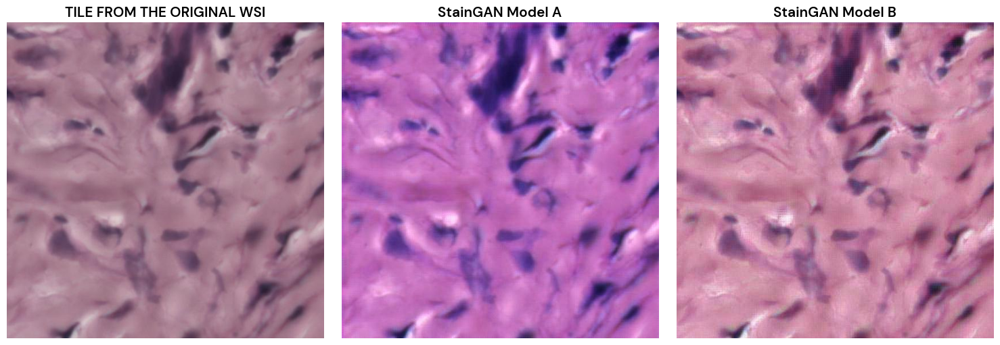

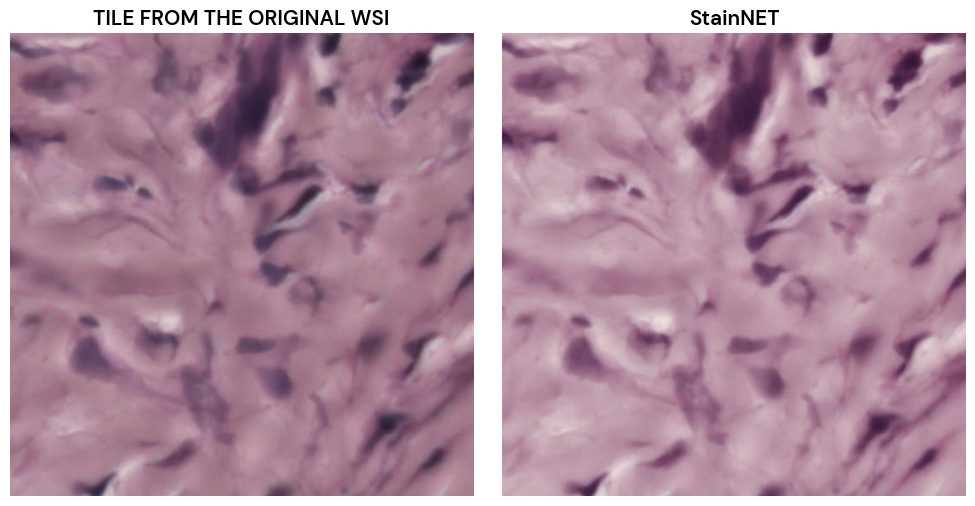

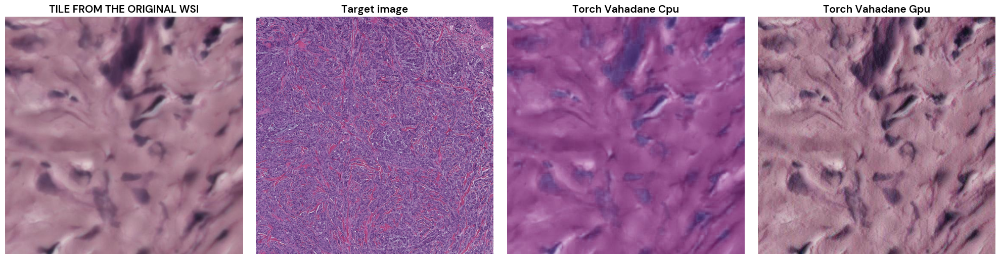

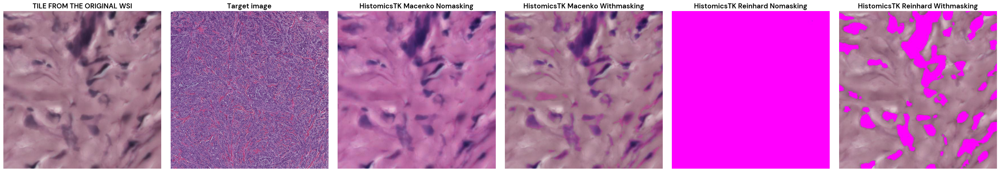

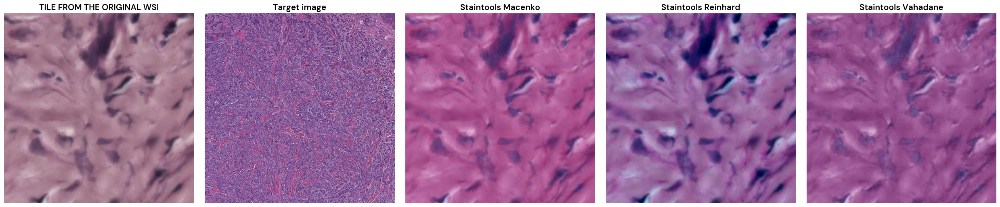

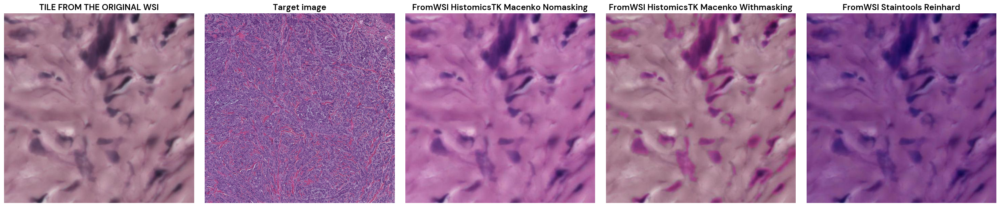

In [40]:
plot_comparison_by_origin(list_of_lists_100, tile_to_visualise=TILE_TO_VISUALISE, tile_size=f"{tile_size}um")

## 2.2 - Visualisation of some 68 um normalised tiles

In [41]:
#print(df_filtered_68)
temp_for_plotting_specific_tile_68 = df_filtered_68.loc[:, ["Normalisation Method", "Path to folder"]]
temp_for_plotting_specific_tile_68.loc[:, "Normalisation Method"] = new_names

list_of_lists_68 = temp_for_plotting_specific_tile_68.values.tolist()
list_of_lists_68.insert(1, ["Target image", PATH_TO_REFERENCE])

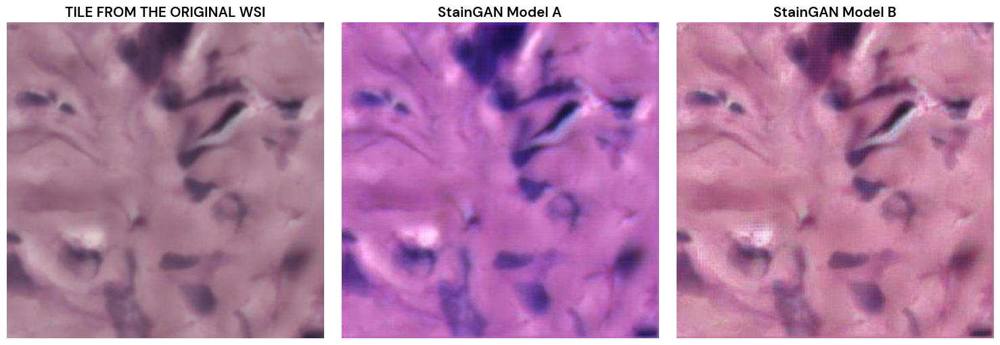

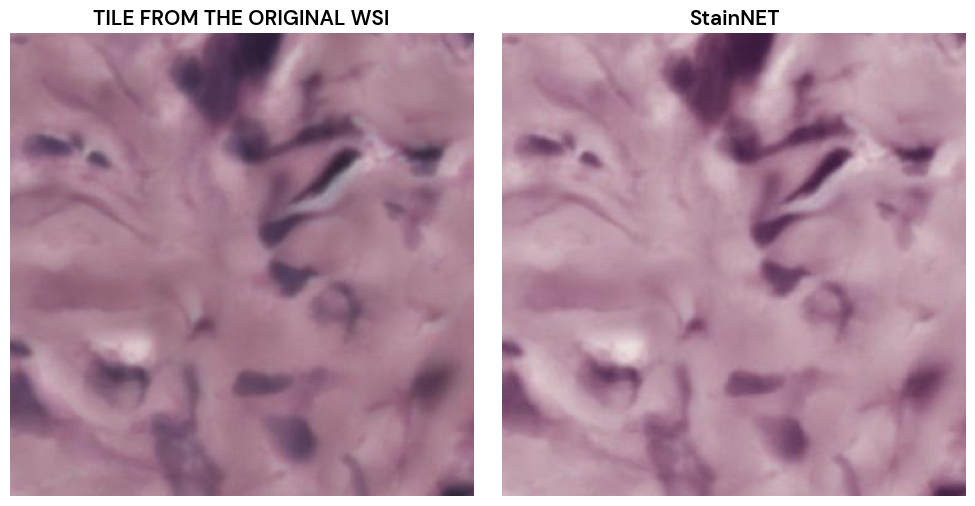

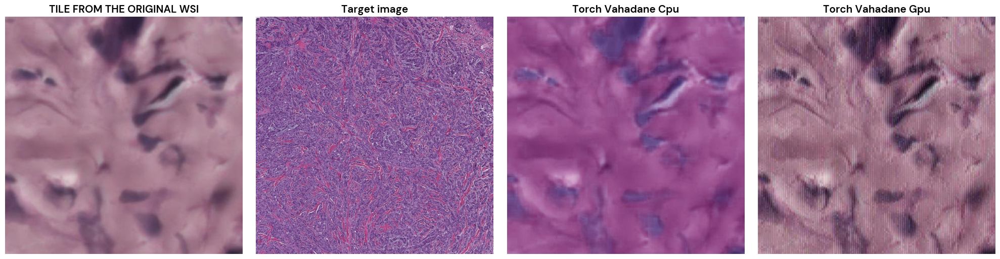

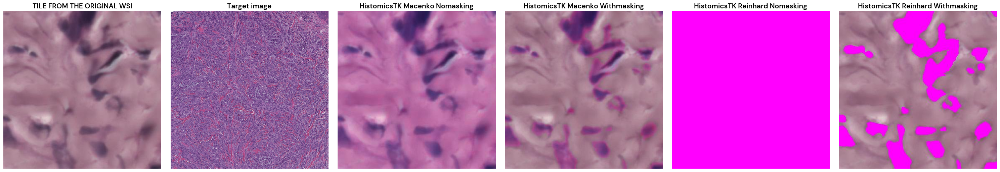

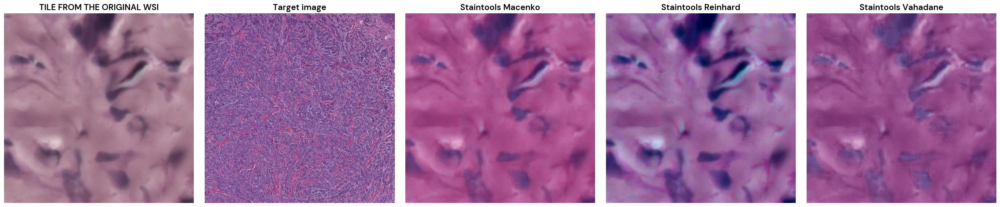

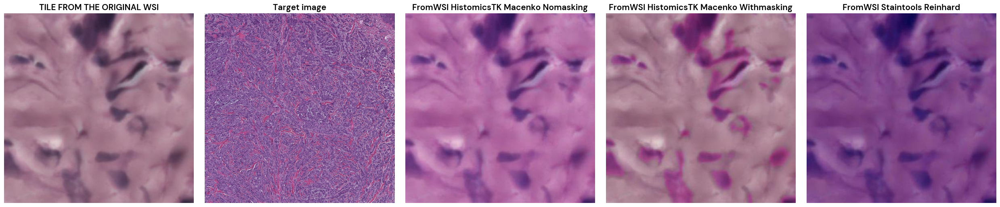

In [42]:
plot_comparison_by_origin(list_of_lists_68, tile_to_visualise=TILE_TO_VISUALISE, tile_size=f"{spot_size}um")

---
## 2.3 - Checking for white tiles

Some tiles will partially be white, so, referring to the original tiles, let's determine which these are based on the "white" background-color sampled from the image.\
In particular, the RGB conversion of the color is `[214, 207, 210]` and can be visualised [here](https://rgb.to/214,207,210).

### 2.3.1 - 100 um tiles

In [43]:
# saving dataframe
too_many_whites_100 = pd.DataFrame(columns = ["Tile name", "White percentage"])
# path to folder
path_to_original_100 = final_summary_for_all_100um_normalised_tiles[final_summary_for_all_100um_normalised_tiles['Normalisation Method'] == 'ORIGINAL WSI']['Path to folder'][0]
# setting the parameters
REFERENCE_COLOR = [214, 207, 210]  # Average RGB of the near-white color, sampled from the image.
tolerance = 50 
white_percentage_threshold = 50

# looping over every tile in the folder
for tile in os.listdir(path_to_original_100):
    tile_result = calculate_white_percentage(os.path.join(path_to_original_100, tile), REFERENCE_COLOR, tolerance, white_percentage_threshold)
    if tile_result is not None:
        too_many_whites_100 = pd.concat([too_many_whites_100, tile_result], ignore_index=True)
    
too_many_whites_100.to_csv(os.path.join(PATH_TO_TILES_DIRECTORY, 
                                        IMAGE_VERSION_AND_COORDINATE_SYSTEM, 
                                        f"original_100um_tiles_with_more_than_{white_percentage_threshold}%_white.csv"))
too_many_whites_100

,Tile name,White percentage
0,GCGATGGCAAACCGTG_row0_col8_100um.jpg,69.721417
1,GTAGCGACATAGTCCG_row11_col11_100um.jpg,50.584209
2,GATGAGGAAATCTCAT_row10_col18_100um.jpg,50.499780
3,CCGAAGACTCTGACGC_row13_col15_100um.jpg,55.533487
4,CAGTCTTTCTAAAGGC_row14_col10_100um.jpg,56.714520
...,...,...
111,AACAAGGGATTAGTGT_row73_col33_100um.jpg,56.852324
112,CTGCCGCTAATCGGGT_row73_col69_100um.jpg,54.603475
113,TAAGGAGATGGTTAAA_row72_col70_100um.jpg,64.655362
114,ACCTCGGGATTCACGG_row75_col87_100um.jpg,64.198605


Let's have a quick visualisation at them.

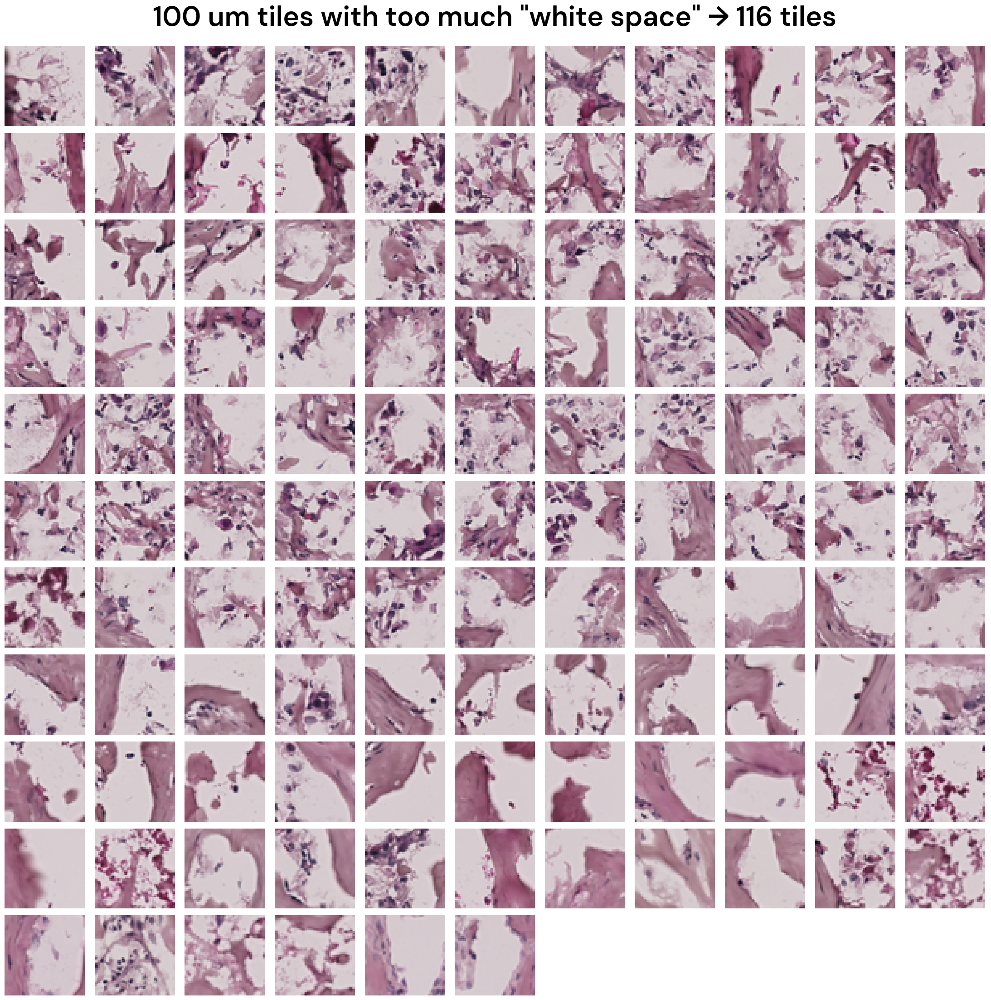

In [44]:
# Number of images
num_images = len(too_many_whites_100)

# Compute optimal rows and cols
n_cols = math.ceil(math.sqrt(num_images))  # Columns to form a square-like shape
n_rows = math.ceil(num_images / n_cols)  # Ensure enough rows to fit all images

# Create a figure and axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 2, n_rows * 2))

# Flatten axes array if multiple rows/columns exist
axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

# Set plot parameters
size_for_plotting = (50, 50)

# Plot images
for i, ax in enumerate(axes):
    if i < num_images:
        tile_path = os.path.join(path_to_original_100, too_many_whites_100.iloc[i][0])
        tile = Image.open(tile_path).resize(size_for_plotting, Image.Resampling.LANCZOS)
        ax.imshow(tile)
        ax.axis("off")  # Hide axes
    else:
        ax.axis("off")  # Hide empty subplots

# Adjust layout
fig.suptitle(f"{tile_size} um tiles with too much \"white space\" → {num_images} tiles", fontsize=n_rows*4, fontweight="bold", y=1.0001)
plt.tight_layout()
fig.savefig(os.path.join(FIGURES_PATH, f"original_{tile_size}um_tiles_with_too_much_white.pdf"), format="pdf", bbox_inches="tight")
fig.savefig(os.path.join(FIGURES_PATH, f"original_{tile_size}um_tiles_with_too_much_white.png"), format="png", dpi=300, bbox_inches="tight")
#plt.show()


### 2.3.2 - 68 um tiles

In [45]:
# saving dataframe
too_many_whites_68 = pd.DataFrame(columns = ["Tile name", "White percentage"])
# path to folder
path_to_original_68 = final_summary_for_all_68um_normalised_tiles[final_summary_for_all_68um_normalised_tiles['Normalisation Method'] == 'ORIGINAL WSI']['Path to folder'][0]
# setting the parameters
REFERENCE_COLOR = [214, 207, 210]  # Average RGB of the near-white color, sampled from the image.
tolerance = 50 
white_percentage_threshold = 50

# looping over every tile in the folder
for tile in os.listdir(path_to_original_68):
    tile_result = calculate_white_percentage(os.path.join(path_to_original_68, tile), REFERENCE_COLOR, tolerance, white_percentage_threshold)
    if tile_result is not None:
        too_many_whites_68 = pd.concat([too_many_whites_68, tile_result], ignore_index=True)
    
too_many_whites_68.to_csv(os.path.join(PATH_TO_TILES_DIRECTORY, 
                                        IMAGE_VERSION_AND_COORDINATE_SYSTEM, 
                                        f"original_68um_tiles_with_more_than_{white_percentage_threshold}%_white.csv"))
too_many_whites_68

,Tile name,White percentage
0,GCGATGGCAAACCGTG_row0_col8_68um.jpg,73.361608
1,TTCATTTGACCTAGTT_row5_col13_68um.jpg,51.557907
2,AAGGTTAATTGCCATA_row8_col50_68um.jpg,50.359033
3,GATGAGGAAATCTCAT_row10_col18_68um.jpg,67.419725
4,GTATATTGATCCGTTG_row12_col14_68um.jpg,56.536771
...,...,...
156,GAACACGGCTATATTC_row72_col96_68um.jpg,68.950337
157,AGGACACAGAGGGAGA_row75_col35_68um.jpg,51.219871
158,ACCTCGGGATTCACGG_row75_col87_68um.jpg,75.596988
159,GGCAAATTCGGGTGTA_row74_col88_68um.jpg,83.282943


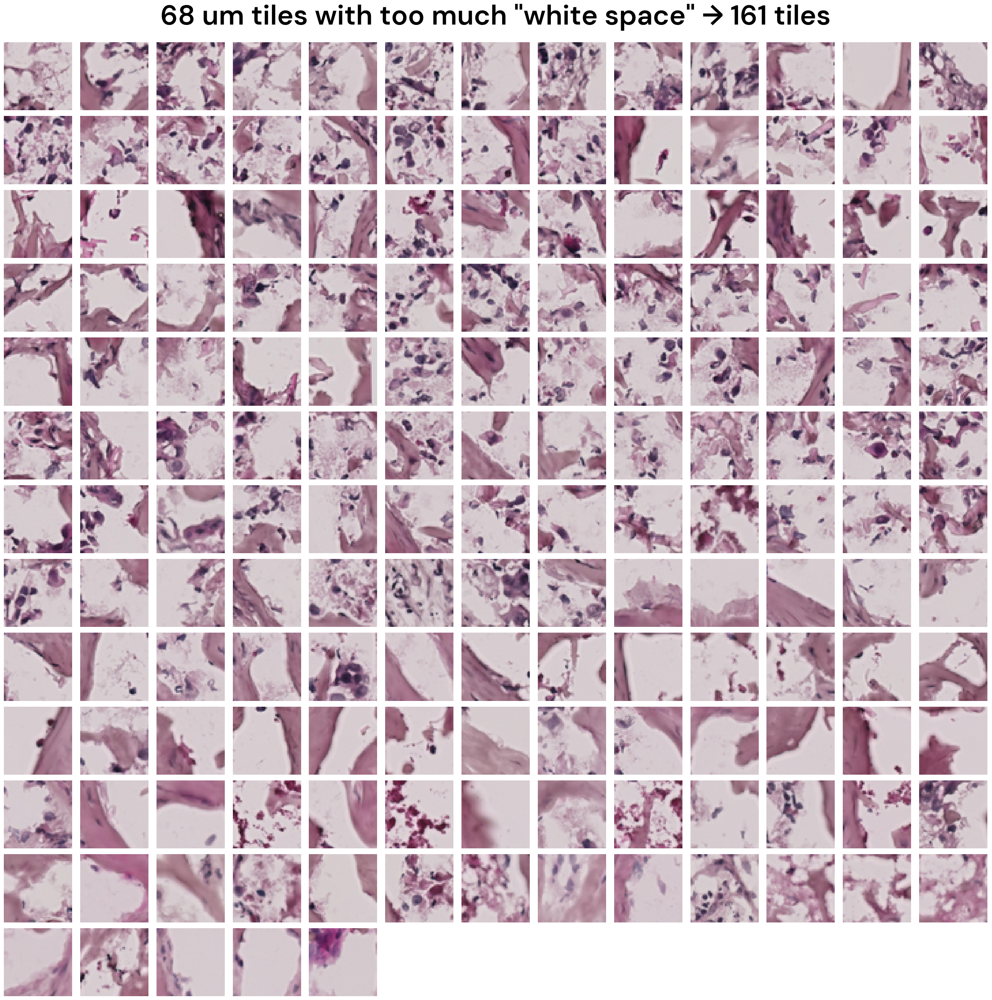

In [46]:
# Number of images
num_images = len(too_many_whites_68)

# Compute optimal rows and cols
n_cols = math.ceil(math.sqrt(num_images))  # Columns to form a square-like shape
n_rows = math.ceil(num_images / n_cols)  # Ensure enough rows to fit all images

# Create a figure and axes
fig, axes = plt.subplots(n_rows, n_cols, figsize=(n_cols * 2, n_rows * 2))

# Flatten axes array if multiple rows/columns exist
axes = axes.flatten() if isinstance(axes, np.ndarray) else [axes]

# Set plot parameters
size_for_plotting = (50, 50)

# Plot images
for i, ax in enumerate(axes):
    if i < num_images:
        tile_path = os.path.join(path_to_original_68, too_many_whites_68.iloc[i][0])
        tile = Image.open(tile_path).resize(size_for_plotting, Image.Resampling.LANCZOS)
        ax.imshow(tile)
        ax.axis("off")  # Hide axes
    else:
        ax.axis("off")  # Hide empty subplots

# Adjust layout
fig.suptitle(f"{spot_size} um tiles with too much \"white space\" → {num_images} tiles", fontsize=n_rows*4, fontweight="bold", y=1.0001)
plt.tight_layout()
fig.savefig(os.path.join(FIGURES_PATH, f"original_{spot_size}um_tiles_with_too_much_white.pdf"), format="pdf", bbox_inches="tight")
fig.savefig(os.path.join(FIGURES_PATH, f"original_{spot_size}um_tiles_with_too_much_white.png"), format="png", dpi=300, bbox_inches="tight")
plt.show()

## 2.4 - Evaluation through SSIM
[SSIM](https://scikit-image.org/docs/dev/auto_examples/transform/plot_ssim.html)

[PSNR](https://scikit-image.org/docs/dev/api/skimage.metrics.html?highlight=structural_similarity#skimage.metrics.peak_signal_noise_ratio)

[LPIPS](https://github.com/richzhang/PerceptualSimilarity/tree/master)

### 2.4.1 - 100 um tiles

In [55]:
excluded_tiles_100 = too_many_whites_100["Tile name"].tolist()
selected_tiles_100 = [i for i in os.listdir(path_to_original_100) if i not in excluded_tiles_100 and i.endswith(".jpg")]
print(f"Number of selected tiles: {len(selected_tiles_100)}")

norm_methods = new_names
norm_paths = df_filtered_100.loc[:, "Path to folder"]

Number of selected tiles: 3515


In [ ]:
ssim_df_100, psnr_df_100 = compute_similarity_metrics(selected_tiles_100, path_to_original_100, norm_methods, norm_paths, tile_size, PATH_TO_NORMALISED_TILES)

The dataframes were saved as `ssim_of_methods_for_non_white_tiles_<TILE_SIZE>um.csv` and `psnr_of_methods_for_non_white_tiles_<TILE_SIZE>um.csv` in the output folder.\
Considering that it takes almost 1 hour for the previous chunk to run, I'm going to access the dataframe from the file in the folder (if it already exists).

In [20]:
ssim_df_100 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{tile_size}", "ssim_of_methods_for_non_white_tiles_100um.csv"), index_col= [0])
ssim_df_100.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
CCGACCACCCTACGCG_row0_col0_100um.jpg,0.952200,0.938224,0.854859,0.981409,0.982031,0.433969,0.763586,0.929194,0.915387,0.969322,0.928237,0.962798,0.920582,0.918928,0.782127
AAGCCATAGTCGCGAC_row1_col1_100um.jpg,0.954039,0.923635,0.871463,0.977485,0.940385,0.439695,0.698531,0.923820,0.924216,0.971773,0.936877,0.948012,0.888378,0.883949,0.611753
TTGGGCGGACCGAAGC_row0_col2_100um.jpg,0.953244,0.927419,0.870704,0.978549,0.940671,0.413622,0.684327,0.927221,0.937454,0.969460,0.953035,0.972379,0.893789,0.887918,0.813365
AGTAAAGCGCATAATC_row1_col3_100um.jpg,0.956958,0.940577,0.878802,0.978074,0.932584,0.437122,0.748231,0.939841,0.948059,0.973199,0.955986,0.965737,0.883512,0.873866,0.650313
CGACTCCGCCGATCAA_row0_col4_100um.jpg,0.952749,0.915742,0.866717,0.976379,0.939606,0.411881,0.641828,0.933391,0.943836,0.969782,0.937855,0.972235,0.879065,0.874493,0.659788
GATATGTAGAGTAGGG_row1_col5_100um.jpg,0.954844,0.916032,0.874890,0.974169,0.931017,0.399814,0.647668,0.933070,0.958596,0.971776,0.947875,0.963380,0.854494,0.850993,0.967243
CGTGACAGTGTCACTT_row0_col6_100um.jpg,0.944189,0.895632,0.807972,0.964002,0.941465,0.376228,0.563961,0.894596,0.913895,0.970524,0.901172,0.891762,0.828735,0.824526,0.891461
GGCCTACTTCTCGGGC_row1_col7_100um.jpg,0.954038,0.923023,0.850598,0.971068,0.956200,0.427067,0.675427,0.927194,0.944057,0.976179,0.911614,0.853915,0.898142,0.895703,0.867098
TGGTCTACGGGTACCT_row1_col11_100um.jpg,0.959446,0.940179,0.879661,0.980043,0.956867,0.397613,0.692788,0.932791,0.972060,0.974003,0.973936,0.934686,0.919883,0.919952,0.863597
GCATGAGGGTAATGCT_row1_col13_100um.jpg,0.959301,0.952270,0.883597,0.981155,0.958700,0.420318,0.786303,0.931924,0.969315,0.976520,0.975199,0.929030,0.941502,0.942084,0.875304


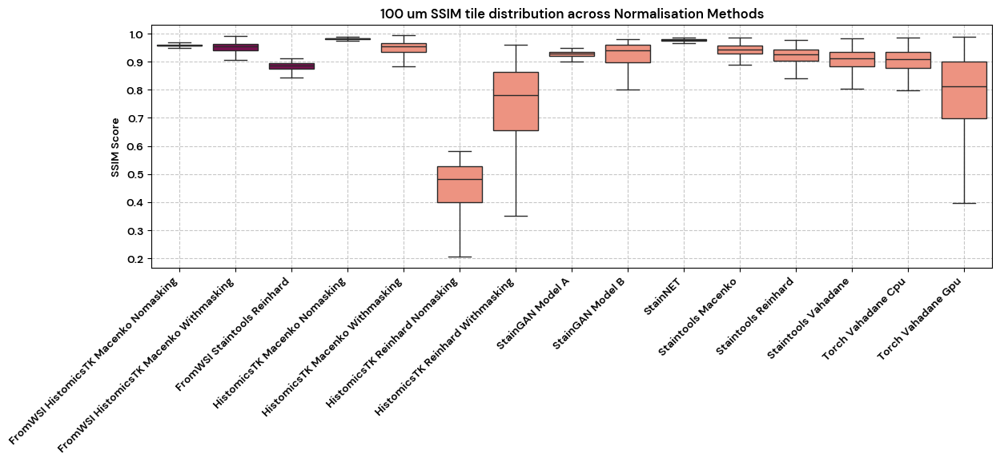

In [21]:
figure_title_ssim_100 = f"{tile_size} um SSIM tile distribution across Normalisation Methods"
ssim_fig_boxplot_100 = plot_boxplot(ssim_df_100, "SSIM", figure_title_ssim_100, median = False)
ssim_fig_boxplot_100

In [ ]:
figure_title_ssim_100 = f"{tile_size} um SSIM tile distribution across Normalisation Methods"
ssim_fig_violinplot_100 = plot_violinplot(ssim_df_100, "SSIM", figure_title_ssim_100, median = False)
#ssim_fig_violinplot_100

In [22]:
ssim_100_median_n_mean = pd.DataFrame([round(ssim_df_100.median(), 3), round(ssim_df_100.mean(), 3)], index = ["Median", "Mean"])
ssim_100_median_n_mean

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
Median,0.959,0.954,0.886,0.982,0.954,0.483,0.780,0.930,0.940,0.977,0.944,0.927,0.913,0.910,0.813
Mean,0.959,0.952,0.883,0.982,0.948,0.459,0.751,0.927,0.925,0.977,0.940,0.923,0.905,0.903,0.782


---

What about the PSNR?

In [23]:
psnr_df_100 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{tile_size}", f"psnr_of_methods_for_non_white_tiles_{tile_size}um.csv"), index_col= [0])
psnr_df_100.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
CCGACCACCCTACGCG_row0_col0_100um.jpg,22.331469,28.473943,14.293520,24.114106,32.641707,6.731146,12.558380,17.932612,17.855248,21.357299,15.317055,21.617899,14.230045,14.294835,20.508100
AAGCCATAGTCGCGAC_row1_col1_100um.jpg,21.937786,27.304674,13.741186,21.672925,27.963427,6.995880,13.286238,18.100186,19.922289,20.280642,19.959970,21.316056,18.182577,18.149190,24.020226
TTGGGCGGACCGAAGC_row0_col2_100um.jpg,22.085302,27.568054,14.581776,22.479741,28.539736,6.871852,12.923249,18.390810,23.327352,21.200692,21.548997,23.245149,20.135823,20.039541,28.088510
AGTAAAGCGCATAATC_row1_col3_100um.jpg,22.406151,28.937511,14.114376,22.524820,23.152448,6.949973,14.143083,19.596538,21.191380,20.808798,21.421546,21.131776,19.204767,19.160087,24.820070
CGACTCCGCCGATCAA_row0_col4_100um.jpg,21.883592,26.266112,14.176931,21.875121,27.279128,6.742828,11.893857,17.992205,20.318368,21.169539,20.615791,22.827596,19.669067,19.575323,22.912698
GATATGTAGAGTAGGG_row1_col5_100um.jpg,22.447619,26.464493,13.792683,21.702332,22.469016,6.739169,12.703538,19.150844,22.427127,20.832515,20.646094,19.925937,18.898323,18.870964,27.094972
CGTGACAGTGTCACTT_row0_col6_100um.jpg,21.925816,22.390454,15.464930,21.964466,24.224111,5.549376,8.070261,16.107256,17.492609,22.874467,14.653901,14.170114,15.042311,14.888930,24.035922
GGCCTACTTCTCGGGC_row1_col7_100um.jpg,23.738571,24.120217,13.617479,23.433237,24.280458,5.843760,10.200754,20.239113,19.136005,22.355171,14.436086,11.958558,13.309224,13.229242,24.240261
TGGTCTACGGGTACCT_row1_col11_100um.jpg,23.244368,28.511396,13.739892,22.629089,22.977208,6.624043,13.453253,20.043230,24.106726,21.286654,21.778353,16.560875,20.850953,20.819833,27.664180
GCATGAGGGTAATGCT_row1_col13_100um.jpg,23.463254,30.530668,13.196989,22.887655,23.192814,6.765760,15.481892,20.640296,24.788642,20.955081,22.788188,15.479986,21.400372,21.415282,21.583752


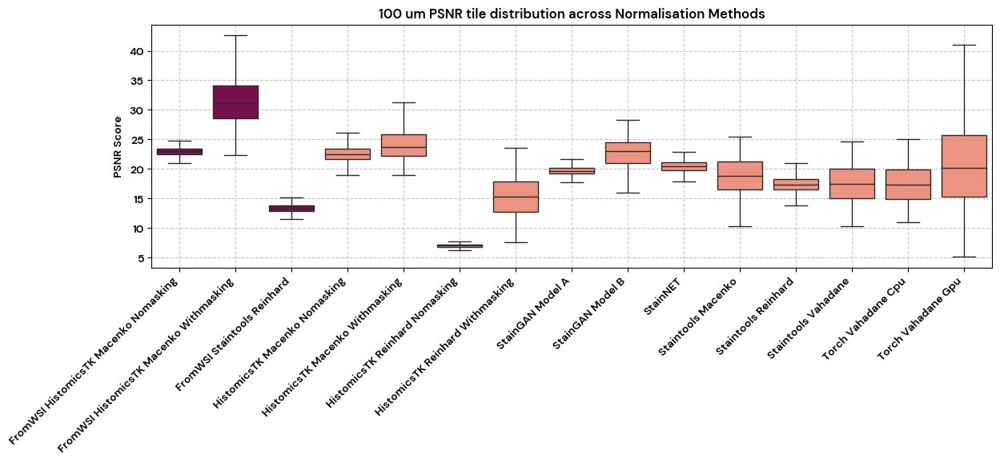

In [24]:
figure_title_psnr_100 = f"{tile_size} um PSNR tile distribution across Normalisation Methods"
psnr_fig_boxplot_100 = plot_boxplot(psnr_df_100, "PSNR", figure_title_psnr_100, median = False)
psnr_fig_boxplot_100

In [ ]:
figure_title_psnr_100 = f"{tile_size} um PSNR tile distribution across Normalisation Methods"
psnr_fig_violinplot_100 = plot_violinplot(psnr_df_100, "PSNR", figure_title_psnr_100, median = False)
#psnr_fig_violinplot_100

In [25]:
psnr_100_median_n_mean = pd.DataFrame([round(psnr_df_100.median(), 3), round(psnr_df_100.mean(), 3)], index = ["Median", "Mean"])
psnr_100_median_n_mean

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
Median,22.939,31.163,13.369,22.398,23.728,7.050,15.246,19.579,23.036,20.375,18.828,17.335,17.387,17.290,20.110
Mean,22.836,31.445,13.299,22.557,24.180,6.975,15.257,19.697,22.508,20.403,18.782,17.289,17.553,17.467,20.984


what about LPSIP?

In [56]:
lpips_df_100 = compute_lpips_metrics(selected_tiles_100, path_to_original_100, norm_methods, norm_paths, tile_size, PATH_TO_NORMALISED_TILES, use_gpu=True)

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /disk2/user/gabgam/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:04<00:00, 54.7MB/s] 


Loading model from: /disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/lpips/weights/v0.1/alex.pth


/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(

In [26]:
lpips_df_100 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{tile_size}", f"lpips_of_methods_for_non_white_tiles_{tile_size}um.csv"), index_col= [0])
lpips_df_100.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
CCGACCACCCTACGCG_row0_col0_100um.jpg,0.117427,0.183724,0.175446,0.074351,0.082840,0.734146,0.575061,0.200408,0.212901,0.069417,0.122785,0.113108,0.128246,0.131234,0.387432
AAGCCATAGTCGCGAC_row1_col1_100um.jpg,0.130673,0.240913,0.211329,0.116672,0.237451,0.784166,0.630357,0.185784,0.198177,0.058875,0.172512,0.116987,0.230892,0.236104,0.426393
TTGGGCGGACCGAAGC_row0_col2_100um.jpg,0.119439,0.196138,0.182274,0.099739,0.204224,0.802248,0.633582,0.193850,0.186660,0.054030,0.140179,0.081191,0.204530,0.209466,0.300821
AGTAAAGCGCATAATC_row1_col3_100um.jpg,0.128240,0.192308,0.196077,0.121027,0.191559,0.786430,0.588959,0.187871,0.157883,0.055353,0.150760,0.100398,0.219716,0.231900,0.434663
CGACTCCGCCGATCAA_row0_col4_100um.jpg,0.123224,0.247624,0.184903,0.108019,0.223764,0.776412,0.673083,0.189218,0.164094,0.062385,0.167623,0.095470,0.232648,0.237781,0.459328
GATATGTAGAGTAGGG_row1_col5_100um.jpg,0.124730,0.258788,0.199164,0.134520,0.203973,0.838895,0.708647,0.211462,0.119800,0.062188,0.176524,0.130020,0.261789,0.267852,0.153598
CGTGACAGTGTCACTT_row0_col6_100um.jpg,0.136924,0.285154,0.218372,0.126428,0.202403,0.696288,0.685523,0.255723,0.228174,0.073101,0.186458,0.178632,0.306126,0.307192,0.347019
GGCCTACTTCTCGGGC_row1_col7_100um.jpg,0.115779,0.198592,0.238500,0.114822,0.141591,0.749064,0.563285,0.205540,0.134689,0.065637,0.135799,0.307827,0.148671,0.151641,0.323285
TGGTCTACGGGTACCT_row1_col11_100um.jpg,0.119570,0.195341,0.200090,0.116615,0.152065,0.807345,0.593731,0.209362,0.084149,0.060648,0.126895,0.182022,0.168082,0.168000,0.227173
GCATGAGGGTAATGCT_row1_col13_100um.jpg,0.122427,0.166710,0.207780,0.121574,0.166695,0.830724,0.551561,0.185667,0.091358,0.060423,0.127934,0.189606,0.145071,0.145120,0.235208


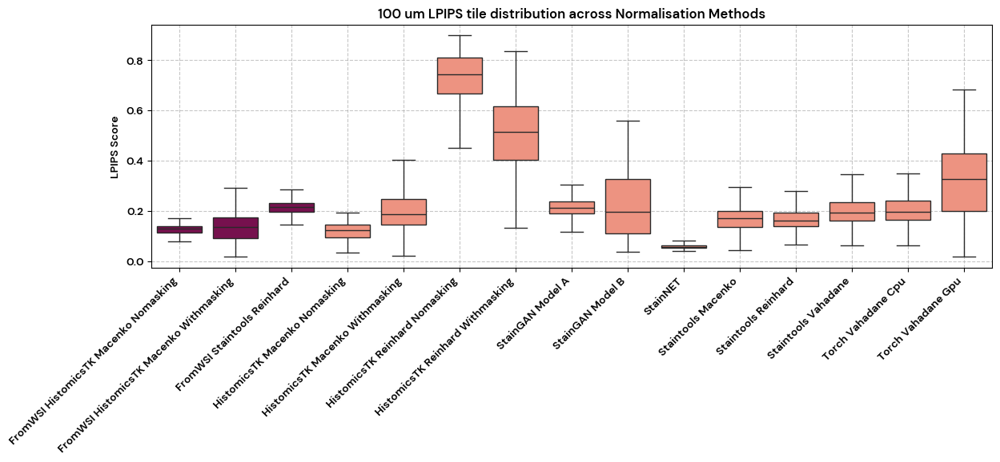

In [27]:
figure_title_lpips_100 = f"{tile_size} um LPIPS tile distribution across Normalisation Methods"
lpips_fig_boxplot_100 = plot_boxplot(lpips_df_100, "LPIPS", figure_title_lpips_100, median = False)
lpips_fig_boxplot_100

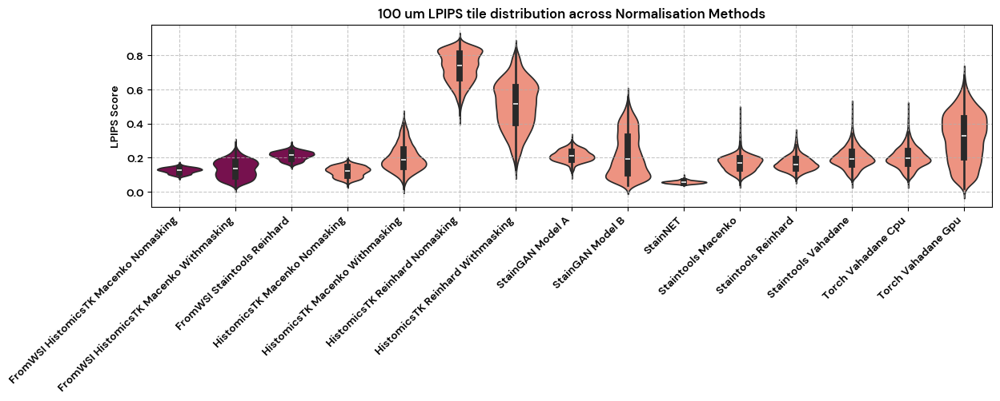

In [30]:
figure_title_lpips_100 = f"{tile_size} um LPIPS tile distribution across Normalisation Methods"
lpips_fig_violinplot_100 = plot_violinplot(lpips_df_100, "LPIPS", figure_title_lpips_100, median = False)
#lpips_fig_violinplot_100

### 2.4.2 - 68 um tiles

In [42]:
excluded_tiles_68 = too_many_whites_68["Tile name"].tolist()
selected_tiles_68 = [i for i in os.listdir(path_to_original_68) if i not in excluded_tiles_68 and i.endswith(".jpg")]
print(f"Number of selected tiles: {len(selected_tiles_68)}")

norm_methods = new_names
norm_paths = df_filtered_68.loc[:, "Path to folder"]
df_filtered_68

Number of selected tiles: 3470


,Normalisation Method,Target,Number of tiles,Path to folder
0,ORIGINAL WSI,-,3631,../1_tiling/output/satac_C1/tiling_output/v3_a...
1,fromWSI_histomicsTK_macenko_nomasking,target_is_reference_full,3631,../1_tiling/output/satac_C1/tiling_output/v3_a...
2,fromWSI_histomicsTK_macenko_withmasking,target_is_reference_full,3631,../1_tiling/output/satac_C1/tiling_output/v3_a...
3,fromWSI_staintools_reinhard,target_is_reference_full,3631,../1_tiling/output/satac_C1/tiling_output/v3_a...
0,histomicsTK_macenko_nomasking,target_is_reference_full,3631,./output/satac_C1/v3_allspots/tiles_68/histomi...
1,histomicsTK_macenko_withmasking,target_is_reference_full,3631,./output/satac_C1/v3_allspots/tiles_68/histomi...
2,histomicsTK_reinhard_nomasking,target_is_reference_full,3631,./output/satac_C1/v3_allspots/tiles_68/histomi...
3,histomicsTK_reinhard_withmasking,target_is_reference_full,3631,./output/satac_C1/v3_allspots/tiles_68/histomi...
4,stainGAN_model_A,-,3631,./output/satac_C1/v3_allspots/tiles_68/stainGA...
5,stainGAN_model_B,-,3631,./output/satac_C1/v3_allspots/tiles_68/stainGA...


In [ ]:
ssim_df_68, psnr_df_68 = compute_similarity_metrics(selected_tiles_68, path_to_original_68, norm_methods, norm_paths, spot_size, PATH_TO_NORMALISED_TILES)

In [31]:
ssim_df_68 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{spot_size}", f"ssim_of_methods_for_non_white_tiles_{spot_size}um.csv"), index_col= [0])
ssim_df_68.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
CCGACCACCCTACGCG_row0_col0_68um.jpg,0.955364,0.946662,0.872573,0.982980,0.975947,0.451075,0.785659,0.898216,0.875130,0.971165,0.978099,0.964500,0.961539,0.965123,0.743397
AAGCCATAGTCGCGAC_row1_col1_68um.jpg,0.951722,0.924821,0.867823,0.978225,0.950269,0.440177,0.717927,0.889037,0.876869,0.971515,0.933627,0.944208,0.865668,0.876915,0.495655
TTGGGCGGACCGAAGC_row0_col2_68um.jpg,0.951440,0.926986,0.868463,0.976530,0.947221,0.402996,0.647993,0.893791,0.892601,0.968539,0.947595,0.968732,0.840428,0.853096,0.756118
AGTAAAGCGCATAATC_row1_col3_68um.jpg,0.956880,0.942405,0.876553,0.977725,0.966647,0.439736,0.757162,0.896864,0.888137,0.973128,0.954345,0.963727,0.956721,0.950559,0.750575
CGACTCCGCCGATCAA_row0_col4_68um.jpg,0.953338,0.913451,0.869392,0.975566,0.936874,0.422382,0.645662,0.897435,0.895421,0.969339,0.933798,0.966268,0.902366,0.902491,0.501942
GATATGTAGAGTAGGG_row1_col5_68um.jpg,0.955035,0.908322,0.872481,0.972936,0.936658,0.388164,0.648099,0.896951,0.904454,0.970494,0.952881,0.967479,0.899580,0.902510,0.488476
CGTGACAGTGTCACTT_row0_col6_68um.jpg,0.944272,0.895342,0.806434,0.966199,0.937205,0.372284,0.565877,0.877420,0.887987,0.971057,0.905766,0.895323,0.847621,0.846757,0.624794
GGCCTACTTCTCGGGC_row1_col7_68um.jpg,0.950572,0.913888,0.840968,0.968156,0.923956,0.409613,0.626832,0.904913,0.906347,0.975268,0.921457,0.838901,0.879792,0.883563,0.409981
TGGTCTACGGGTACCT_row1_col11_68um.jpg,0.957293,0.923539,0.869040,0.977921,0.942361,0.344240,0.595548,0.879122,0.902067,0.970157,0.961605,0.953646,0.939219,0.938909,0.801351
GCATGAGGGTAATGCT_row1_col13_68um.jpg,0.958523,0.952926,0.879716,0.979969,0.969069,0.401876,0.762781,0.881881,0.899587,0.976295,0.974730,0.927643,0.938810,0.952649,0.773252


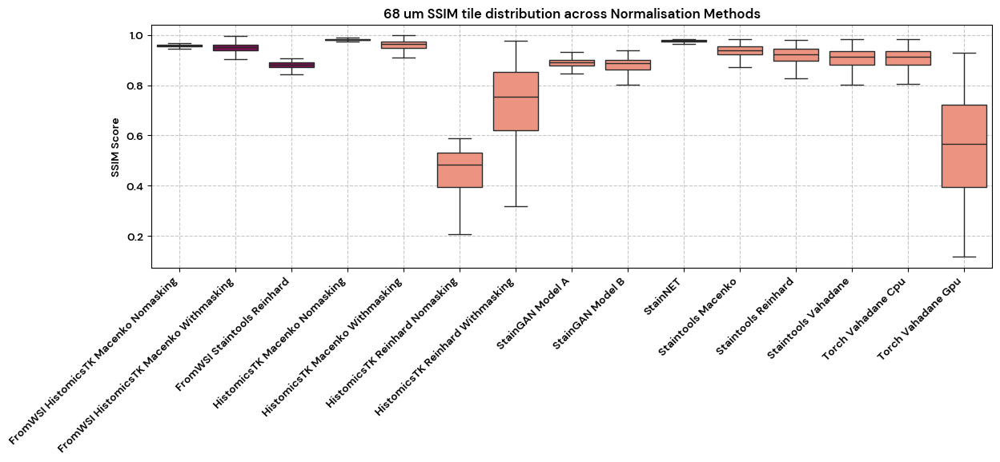

In [32]:
figure_title_ssim_68 = f"{spot_size} um SSIM tile distribution across Normalisation Methods"
ssim_fig_boxplot_68 = plot_boxplot(ssim_df_68, "SSIM", figure_title_ssim_68, median = False)
ssim_fig_boxplot_68

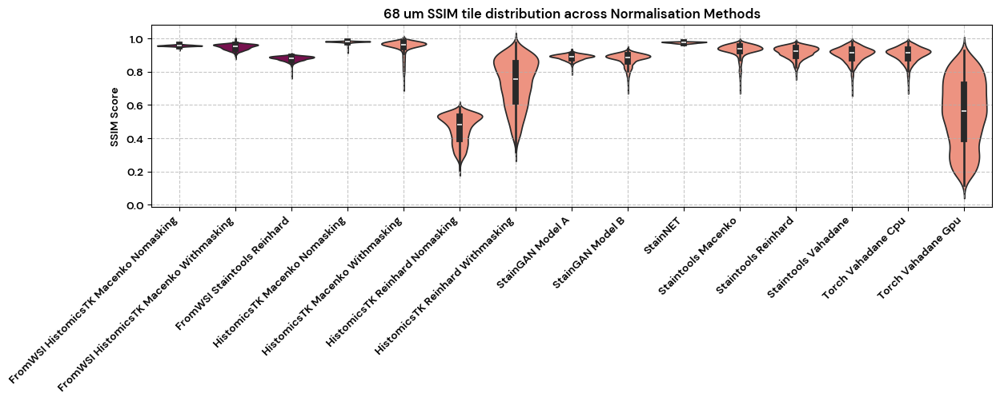

In [33]:
figure_title_ssim_68 = f"{spot_size} um SSIM tile distribution across Normalisation Methods"
ssim_fig_violinplot_68 = plot_violinplot(ssim_df_68, "SSIM", figure_title_ssim_68, median = False)
ssim_fig_violinplot_68

In [34]:
ssim_68_median_n_mean = pd.DataFrame([round(ssim_df_68.median(), 3), round(ssim_df_68.mean(), 3)], index = ["Median", "Mean"])
ssim_68_median_n_mean

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
Median,0.957,0.952,0.883,0.981,0.964,0.484,0.755,0.891,0.887,0.977,0.939,0.923,0.912,0.913,0.565
Mean,0.957,0.949,0.880,0.980,0.951,0.459,0.730,0.889,0.876,0.976,0.930,0.917,0.904,0.905,0.553


What about the PSNR?

In [35]:
psnr_df_68 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{spot_size}", f"psnr_of_methods_for_non_white_tiles_{spot_size}um.csv"), index_col= [0])
psnr_df_68.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
CCGACCACCCTACGCG_row0_col0_68um.jpg,21.869543,29.978982,14.145557,23.414684,31.579559,7.075716,14.787035,18.896831,18.371378,20.964518,22.155133,22.238500,22.322161,22.151888,28.315712
AAGCCATAGTCGCGAC_row1_col1_68um.jpg,21.780712,27.179969,13.357132,21.628837,27.794468,7.004694,13.447156,18.595146,20.788766,20.178621,19.128893,21.434502,17.105803,17.271094,23.780543
TTGGGCGGACCGAAGC_row0_col2_68um.jpg,21.724641,27.343100,14.381051,22.200085,27.840297,6.859218,12.523667,18.205894,22.173992,21.034519,21.138921,23.046301,18.650628,18.979342,29.674675
AGTAAAGCGCATAATC_row1_col3_68um.jpg,22.232455,28.968996,13.874550,22.269172,29.886520,6.965724,14.271534,19.099626,20.370095,20.717829,21.142003,21.267752,20.427023,20.143192,24.778507
CGACTCCGCCGATCAA_row0_col4_68um.jpg,21.606040,26.324534,14.158215,21.606869,26.800771,6.790816,12.229800,17.137925,18.804018,20.786669,20.270897,22.591992,19.950221,19.949807,23.848089
GATATGTAGAGTAGGG_row1_col5_68um.jpg,22.364011,26.355411,13.937261,21.371363,26.877491,6.701189,12.767504,18.896549,22.867473,20.847768,20.492032,21.057373,19.859383,19.994321,23.708329
CGTGACAGTGTCACTT_row0_col6_68um.jpg,21.693569,22.403495,15.546989,21.977071,24.793682,5.545413,8.090282,16.157974,17.464905,22.931972,15.087460,14.063419,15.055375,15.084310,19.325802
GGCCTACTTCTCGGGC_row1_col7_68um.jpg,23.649708,23.280796,13.724155,23.166930,25.311961,5.665329,9.260809,20.550863,19.981502,22.819416,15.852461,11.680778,14.986298,14.894226,18.147842
TGGTCTACGGGTACCT_row1_col11_68um.jpg,22.730992,26.673182,14.256368,22.402206,27.027076,6.553184,12.079099,18.753912,23.359099,21.566028,20.637107,19.586602,20.700692,20.706467,30.226948
GCATGAGGGTAATGCT_row1_col13_68um.jpg,23.628027,30.599098,13.070271,23.014798,29.666360,6.797761,15.403976,20.335467,23.167054,20.818013,22.860127,15.121891,21.276873,21.745505,21.100901


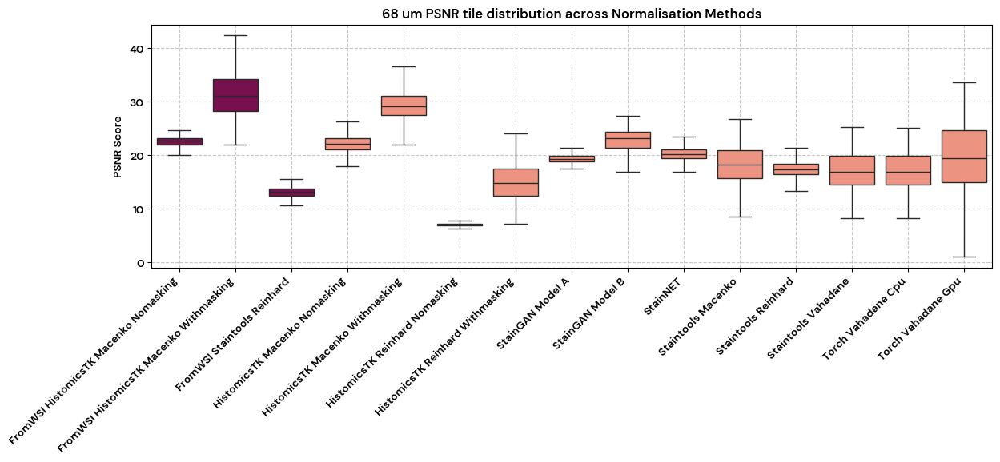

In [36]:
figure_title_psnr_68 = f"{spot_size} um PSNR tile distribution across Normalisation Methods"
psnr_fig_boxplot_68 = plot_boxplot(psnr_df_68, "PSNR", figure_title_psnr_68, median = False)
psnr_fig_boxplot_68

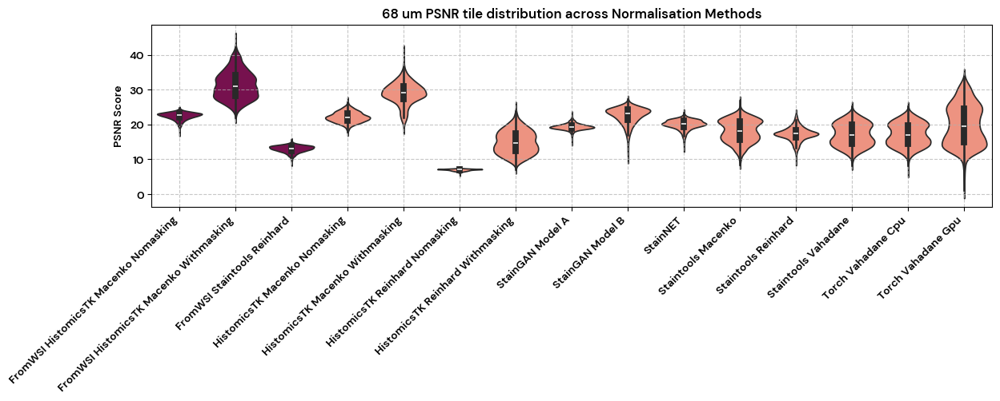

In [37]:
figure_title_psnr_68 = f"{spot_size} um PSNR tile distribution across Normalisation Methods"
psnr_fig_violinplot_68 = plot_violinplot(psnr_df_68, "PSNR", figure_title_psnr_68, median = False)
psnr_fig_violinplot_68

In [38]:
psnr_68_median_n_mean = pd.DataFrame([round(psnr_df_68.median(), 3), round(psnr_df_68.mean(), 3)], index = ["Median", "Mean"])
psnr_68_median_n_mean

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
Median,22.651,31.066,13.141,22.065,29.158,7.063,14.714,19.298,23.115,20.193,18.207,17.342,16.921,16.928,19.427
Mean,22.440,31.398,13.002,22.147,29.023,6.984,14.937,19.356,22.525,20.021,18.123,17.298,17.110,17.119,19.846


In [45]:
lpips_df_68 = compute_lpips_metrics(selected_tiles_68, path_to_original_68, norm_methods, norm_paths, spot_size, PATH_TO_NORMALISED_TILES, use_gpu=True)

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/lpips/weights/v0.1/alex.pth


/disk2/user/gabgam/miniconda3/envs/he_vis_eval/lib/python3.8/site-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(

In [46]:
lpips_df_68 = pd.read_csv(os.path.join(PATH_TO_NORMALISED_TILES, f"tiles_{spot_size}", f"lpips_of_methods_for_non_white_tiles_{spot_size}um.csv"), index_col= [0])
lpips_df_68.iloc[:10, :]

,FromWSI HistomicsTK Macenko Nomasking,FromWSI HistomicsTK Macenko Withmasking,FromWSI Staintools Reinhard,HistomicsTK Macenko Nomasking,HistomicsTK Macenko Withmasking,HistomicsTK Reinhard Nomasking,HistomicsTK Reinhard Withmasking,StainGAN Model A,StainGAN Model B,StainNET,Staintools Macenko,Staintools Reinhard,Staintools Vahadane,Torch Vahadane Cpu,Torch Vahadane Gpu
CCGACCACCCTACGCG_row0_col0_68um.jpg,0.123650,0.163573,0.178920,0.083996,0.136155,0.725067,0.595939,0.173056,0.206594,0.060325,0.081648,0.087042,0.092744,0.090280,0.780342
AAGCCATAGTCGCGAC_row1_col1_68um.jpg,0.129295,0.217201,0.197600,0.116187,0.203184,0.752802,0.576473,0.186993,0.191797,0.055963,0.176502,0.122777,0.236951,0.227572,0.806673
TTGGGCGGACCGAAGC_row0_col2_68um.jpg,0.117413,0.193684,0.171777,0.100382,0.194779,0.803203,0.663579,0.174316,0.165229,0.054140,0.145987,0.078295,0.237455,0.228131,0.754122
AGTAAAGCGCATAATC_row1_col3_68um.jpg,0.125815,0.178676,0.187986,0.118584,0.160073,0.758206,0.586912,0.185667,0.187680,0.049240,0.148384,0.094559,0.136690,0.144160,0.755273
CGACTCCGCCGATCAA_row0_col4_68um.jpg,0.126956,0.218550,0.179019,0.112728,0.205580,0.740762,0.641955,0.187933,0.159870,0.059594,0.171267,0.093244,0.206186,0.205912,0.914146
GATATGTAGAGTAGGG_row1_col5_68um.jpg,0.116517,0.259889,0.182166,0.125872,0.265988,0.820938,0.718415,0.209580,0.133159,0.059787,0.163477,0.116271,0.210256,0.208789,0.932648
CGTGACAGTGTCACTT_row0_col6_68um.jpg,0.135326,0.275089,0.209796,0.126833,0.232982,0.682095,0.661928,0.240012,0.195465,0.070777,0.192963,0.173090,0.277564,0.283099,0.819262
GGCCTACTTCTCGGGC_row1_col7_68um.jpg,0.119174,0.198800,0.238955,0.114239,0.236785,0.738219,0.584774,0.190738,0.146439,0.069045,0.155337,0.316500,0.221178,0.212217,0.806555
TGGTCTACGGGTACCT_row1_col11_68um.jpg,0.120799,0.240358,0.184523,0.119077,0.240876,0.815664,0.697983,0.233322,0.118279,0.067253,0.146892,0.144590,0.164514,0.166594,0.698260
GCATGAGGGTAATGCT_row1_col13_68um.jpg,0.125135,0.155162,0.199557,0.123376,0.183553,0.832047,0.587602,0.197373,0.095377,0.056645,0.128105,0.178309,0.143740,0.133342,0.636339


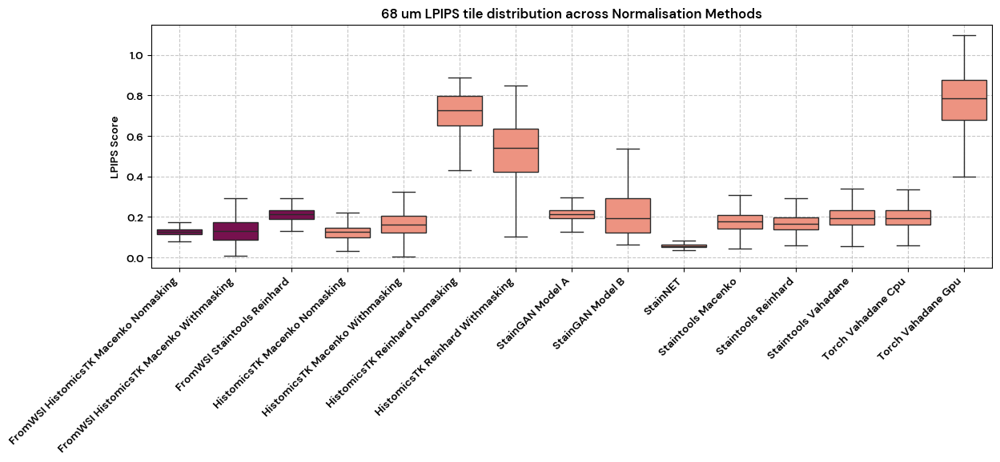

In [47]:
figure_title_lpips_68 = f"{spot_size} um LPIPS tile distribution across Normalisation Methods"
lpips_fig_boxplot_68 = plot_boxplot(lpips_df_68, "LPIPS", figure_title_lpips_68, median = False)
lpips_fig_boxplot_68

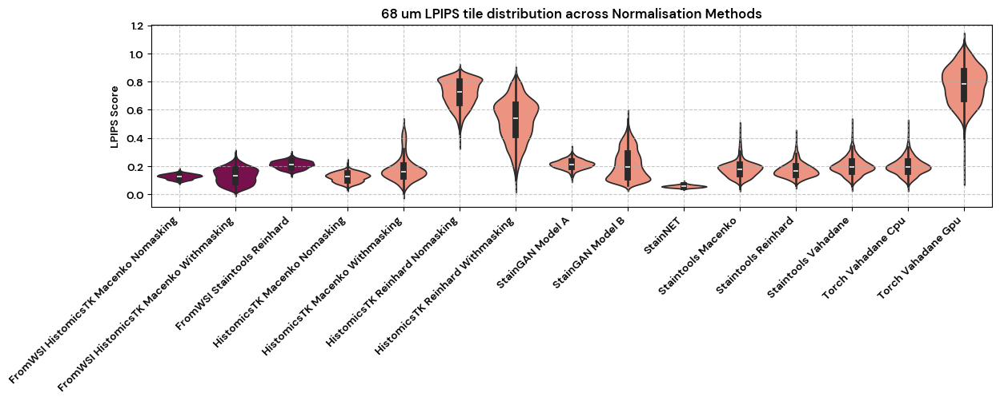

In [48]:
figure_title_lpips_68 = f"{spot_size} um LPIPS tile distribution across Normalisation Methods"
lpips_fig_violinplot_68 = plot_violinplot(lpips_df_68, "LPIPS", figure_title_lpips_68, median = False)
lpips_fig_violinplot_68

---
**Saving the environment requirements**

In [49]:
# Save package versions to a .txt file
with open("requirements_for_visualisation_n_evaluation_env.txt", "w") as f:
    subprocess.run(["pip", "freeze"], stdout=f)